# Telecom customer churn Prediction - Exploratory Data Analysis

In [42]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import folium
import branca.colormap as cm

import warnings
warnings.filterwarnings('ignore')


## Load Data

In [2]:
telecom_data = pd.read_excel("../data/Telco_customer_churn.xlsx")
telecom_data

,CustomerID,Count,Country,State,City,Zip Code,Lat Long,Latitude,Longitude,Gender,...,Contract,Paperless Billing,Payment Method,Monthly Charges,Total Charges,Churn Label,Churn Value,Churn Score,CLTV,Churn Reason
0,3668-QPYBK,1,United States,California,Los Angeles,90003,"33.964131, -118.272783",33.964131,-118.272783,Male,...,Month-to-month,Yes,Mailed check,53.85,108.15,Yes,1,86,3239,Competitor made better offer
1,9237-HQITU,1,United States,California,Los Angeles,90005,"34.059281, -118.30742",34.059281,-118.307420,Female,...,Month-to-month,Yes,Electronic check,70.70,151.65,Yes,1,67,2701,Moved
2,9305-CDSKC,1,United States,California,Los Angeles,90006,"34.048013, -118.293953",34.048013,-118.293953,Female,...,Month-to-month,Yes,Electronic check,99.65,820.5,Yes,1,86,5372,Moved
3,7892-POOKP,1,United States,California,Los Angeles,90010,"34.062125, -118.315709",34.062125,-118.315709,Female,...,Month-to-month,Yes,Electronic check,104.80,3046.05,Yes,1,84,5003,Moved
4,0280-XJGEX,1,United States,California,Los Angeles,90015,"34.039224, -118.266293",34.039224,-118.266293,Male,...,Month-to-month,Yes,Bank transfer (automatic),103.70,5036.3,Yes,1,89,5340,Competitor had better devices
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,2569-WGERO,1,United States,California,Landers,92285,"34.341737, -116.539416",34.341737,-116.539416,Female,...,Two year,Yes,Bank transfer (automatic),21.15,1419.4,No,0,45,5306,NaN
7039,6840-RESVB,1,United States,California,Adelanto,92301,"34.667815, -117.536183",34.667815,-117.536183,Male,...,One year,Yes,Mailed check,84.80,1990.5,No,0,59,2140,NaN
7040,2234-XADUH,1,United States,California,Amboy,92304,"34.559882, -115.637164",34.559882,-115.637164,Female,...,One year,Yes,Credit card (automatic),103.20,7362.9,No,0,71,5560,NaN
7041,4801-JZAZL,1,United States,California,Angelus Oaks,92305,"34.1678, -116.86433",34.167800,-116.864330,Female,...,Month-to-month,Yes,Electronic check,29.60,346.45,No,0,59,2793,NaN


## Explore Data

In [3]:
telecom_data.columns

Index(['CustomerID', 'Count', 'Country', 'State', 'City', 'Zip Code',
       'Lat Long', 'Latitude', 'Longitude', 'Gender', 'Senior Citizen',
       'Partner', 'Dependents', 'Tenure Months', 'Phone Service',
       'Multiple Lines', 'Internet Service', 'Online Security',
       'Online Backup', 'Device Protection', 'Tech Support', 'Streaming TV',
       'Streaming Movies', 'Contract', 'Paperless Billing', 'Payment Method',
       'Monthly Charges', 'Total Charges', 'Churn Label', 'Churn Value',
       'Churn Score', 'CLTV', 'Churn Reason'],
      dtype='object')

In [4]:
columns_to_drop = ['Latitude', 'Longitude','Churn Label','CustomerID']

In [5]:
telecom_data[['Phone Service',
       'Multiple Lines', 'Internet Service', 'Online Security',
       'Online Backup', 'Device Protection', 'Tech Support', 'Streaming TV',
       'Streaming Movies']]

,Phone Service,Multiple Lines,Internet Service,Online Security,Online Backup,Device Protection,Tech Support,Streaming TV,Streaming Movies
0,Yes,No,DSL,Yes,Yes,No,No,No,No
1,Yes,No,Fiber optic,No,No,No,No,No,No
2,Yes,Yes,Fiber optic,No,No,Yes,No,Yes,Yes
3,Yes,Yes,Fiber optic,No,No,Yes,Yes,Yes,Yes
4,Yes,Yes,Fiber optic,No,Yes,Yes,No,Yes,Yes
...,...,...,...,...,...,...,...,...,...
7038,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service
7039,Yes,Yes,DSL,Yes,No,Yes,Yes,Yes,Yes
7040,Yes,Yes,Fiber optic,No,Yes,Yes,No,Yes,Yes
7041,No,No phone service,DSL,Yes,No,No,No,No,No


## Initial Data Analysis

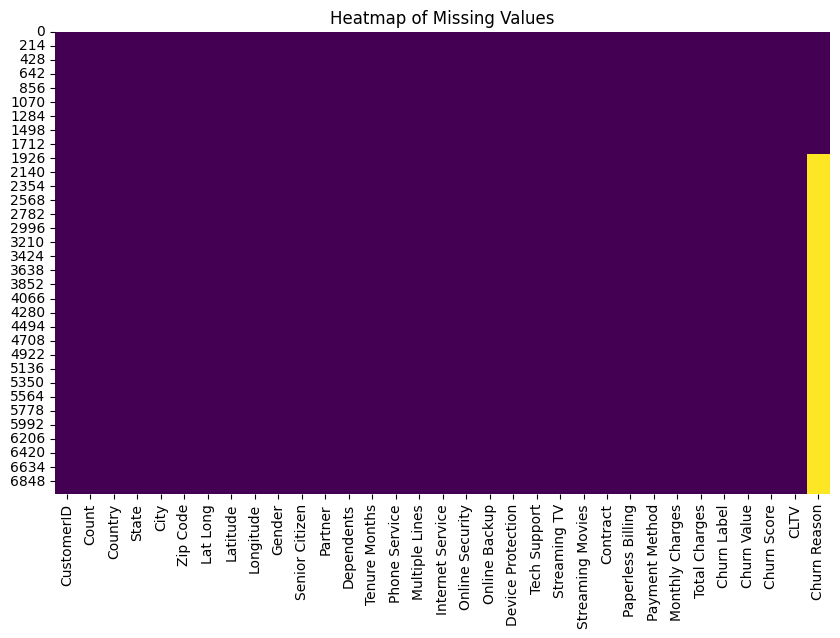

In [6]:
plt.figure(figsize=(10, 6))
sns.heatmap(telecom_data.isnull(), cmap='viridis', cbar=False)
plt.title("Heatmap of Missing Values")
plt.show()


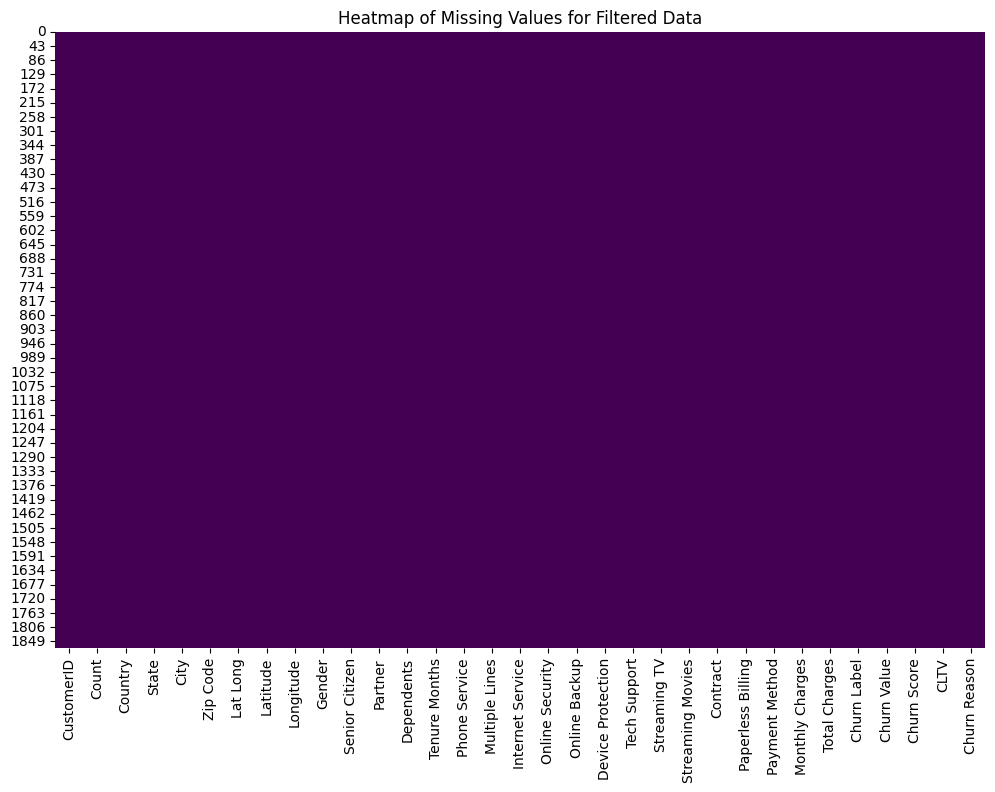

In [7]:
mask = telecom_data['Churn Value'] == 1

# Filter the DataFrame using the mask
filtered_data = telecom_data[mask]

# Generate a heatmap to visualize missing values in the filtered data
plt.figure(figsize=(12, 8))
sns.heatmap(filtered_data.isnull(), cbar=False, cmap='viridis')
plt.title("Heatmap of Missing Values for Filtered Data")
plt.show()

In [8]:
telecom_data['Churn Reason'] = telecom_data['Churn Reason'].fillna("Existing User")

In [9]:
telecom_data.isna().sum()

CustomerID           0
Count                0
Country              0
State                0
City                 0
Zip Code             0
Lat Long             0
Latitude             0
Longitude            0
Gender               0
Senior Citizen       0
Partner              0
Dependents           0
Tenure Months        0
Phone Service        0
Multiple Lines       0
Internet Service     0
Online Security      0
Online Backup        0
Device Protection    0
Tech Support         0
Streaming TV         0
Streaming Movies     0
Contract             0
Paperless Billing    0
Payment Method       0
Monthly Charges      0
Total Charges        0
Churn Label          0
Churn Value          0
Churn Score          0
CLTV                 0
Churn Reason         0
dtype: int64

### Churn vs existing customer

In [10]:
churn_summary = telecom_data.groupby('Churn Value')
churn_summary[['Tenure Months','Monthly Charges']].mean()

,Tenure Months,Monthly Charges
Churn Value,,
0,37.569965,61.265124
1,17.979133,74.441332


In [11]:
def categorical_var_churn_dist(feature,filterFea=''):
    if filterFea != '':
        feature_summary = telecom_data[telecom_data[filterFea]!='No'].groupby('Churn Value')[feature].value_counts(normalize=True).reset_index(name='Percentage')
        print(feature," summary: \n ", feature_summary)
        sns.catplot(x=feature
                    , y='Percentage'
                    , hue = feature
                    , data = feature_summary
                    , col='Churn Value'
                    , kind='bar'
                    , alpha = 0.6
                    , palette = sns.color_palette("pastel6"))
        plt.show()
    else:
        feature_summary = churn_summary[feature].value_counts(normalize=True).reset_index(name='Percentage')
        print(feature," summary: \n ", feature_summary)
        g = sns.catplot(x=feature
                    , y='Percentage'
                    , data = feature_summary
                    , hue = feature
                    , col='Churn Value'
                    , kind="bar"
                    , alpha = 0.6
                    , palette = sns.color_palette("pastel6"))
        g.set_xticklabels(rotation=45)
        plt.show()
        

Gender  summary: 
     Churn Value  Gender  Percentage
0            0    Male    0.507344
1            0  Female    0.492656
2            1  Female    0.502408
3            1    Male    0.497592


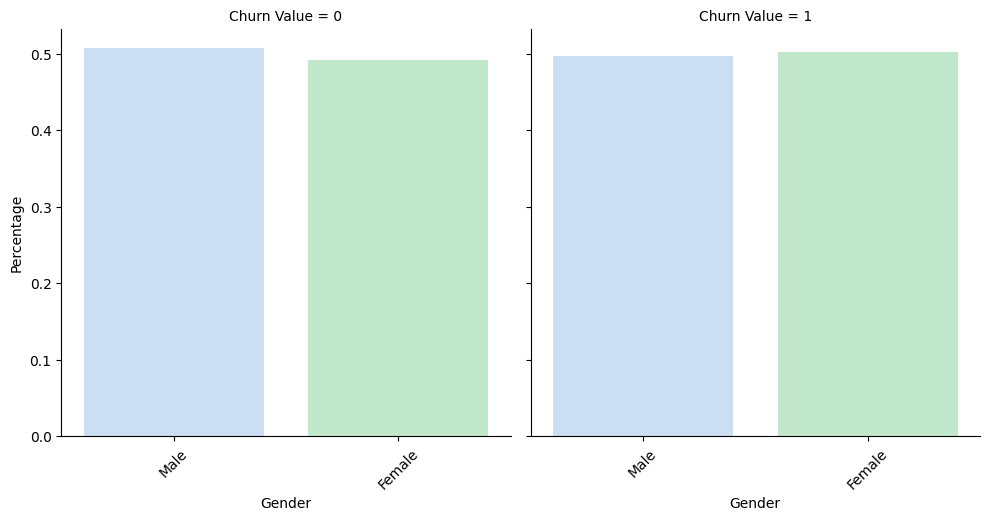

In [12]:
categorical_var_churn_dist('Gender')

<b>Gender is equally distributed in existing as well as churn subscribers. So, gender is not helping in the prediction of churn. </b>

Senior Citizen  summary: 
     Churn Value Senior Citizen  Percentage
0            0             No    0.871279
1            0            Yes    0.128721
2            1             No    0.745318
3            1            Yes    0.254682


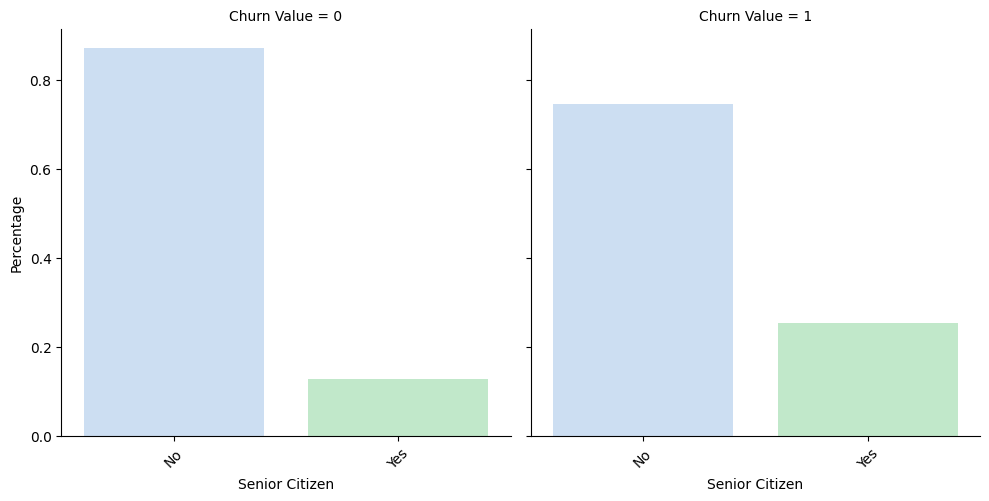

In [13]:
categorical_var_churn_dist('Senior Citizen')

<b>Percentage of senior citizen are more likely to be churn compared to existing senior citizen distribution.</b>

Partner  summary: 
     Churn Value Partner  Percentage
0            0     Yes    0.528218
1            0      No    0.471782
2            1      No    0.642055
3            1     Yes    0.357945


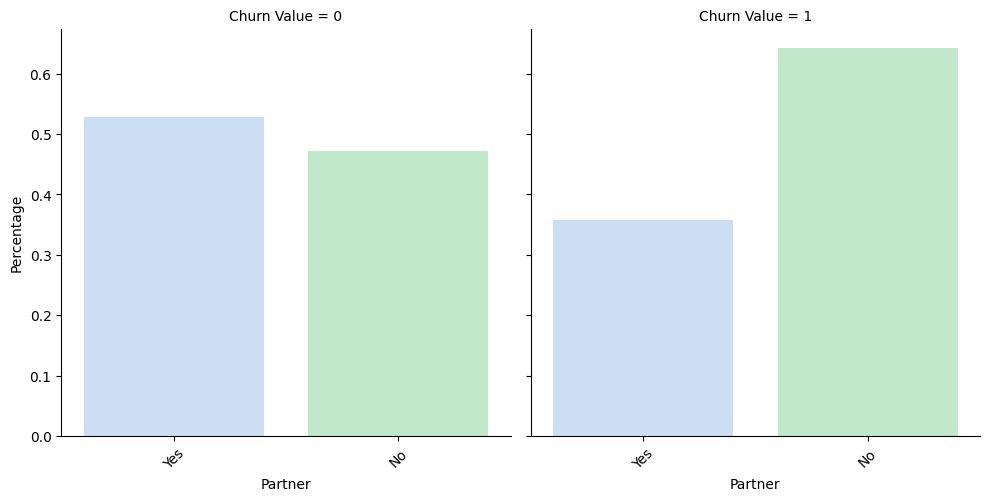

In [14]:
categorical_var_churn_dist('Partner')

Dependents  summary: 
     Churn Value Dependents  Percentage
0            0         No    0.706030
1            0        Yes    0.293970
2            1         No    0.943285
3            1        Yes    0.056715


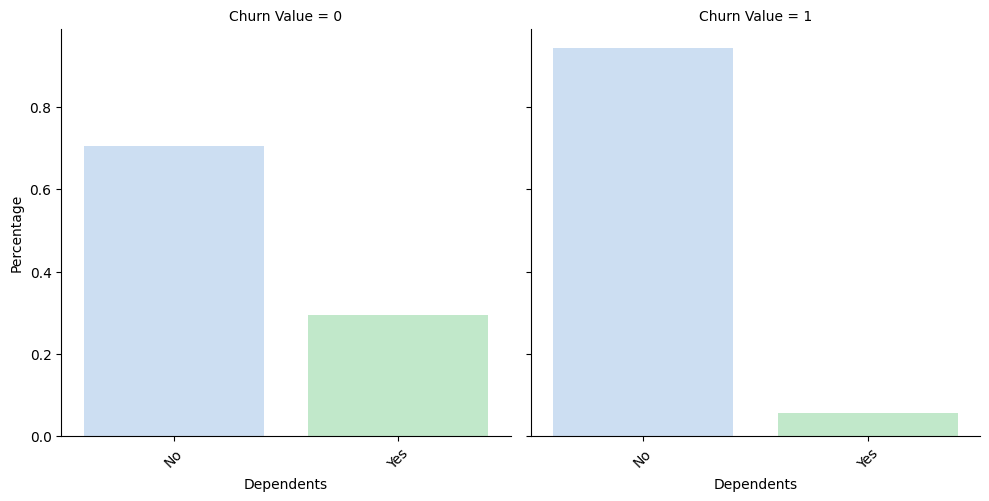

In [15]:
categorical_var_churn_dist('Dependents')

<b>However, for partners and dependents, it's inversely true.</b>

Phone Service  summary: 
     Churn Value Phone Service  Percentage
0            0           Yes    0.901044
1            0            No    0.098956
2            1           Yes    0.909042
3            1            No    0.090958


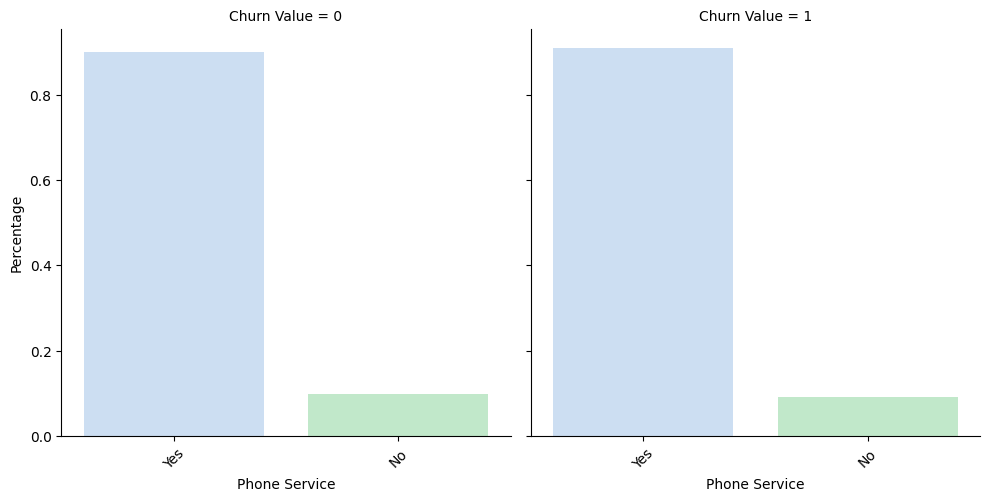

In [16]:
categorical_var_churn_dist('Phone Service')

Internet Service  summary: 
     Churn Value Internet Service  Percentage
0            0              DSL    0.379204
1            0      Fiber optic    0.347700
2            0               No    0.273096
3            1      Fiber optic    0.693954
4            1              DSL    0.245586
5            1               No    0.060460


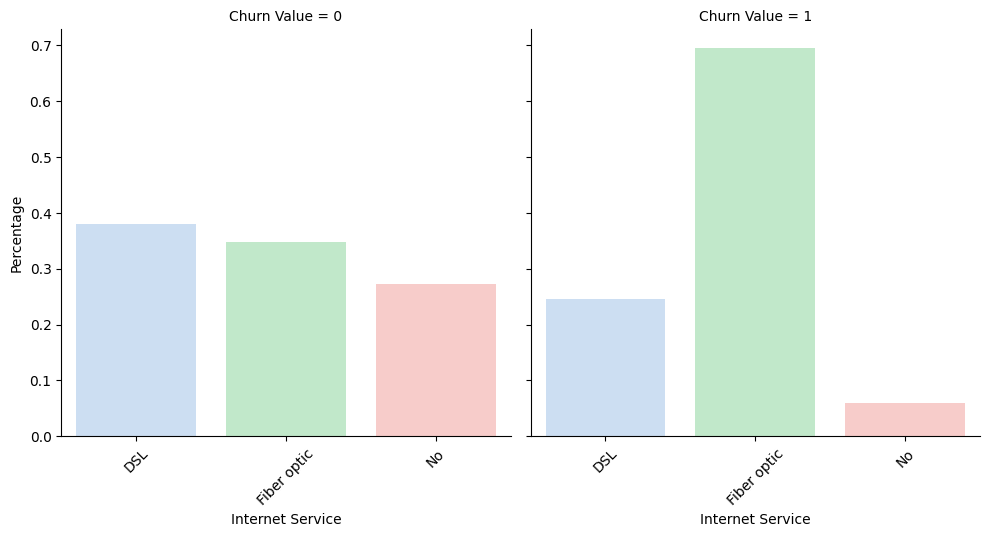

In [17]:
categorical_var_churn_dist('Internet Service')

<b>From internet and phone service, 93% of the churn customer had internet service compared to 72% of existing customer have internet service.</b>

<b>Churn subscriber likely to have fiber optic(73%) internet service rather than DSL service</b>

Streaming TV  summary: 
     Churn Value Streaming TV  Percentage
0            0          Yes    0.503324
1            0           No    0.496676
2            1           No    0.536446
3            1          Yes    0.463554


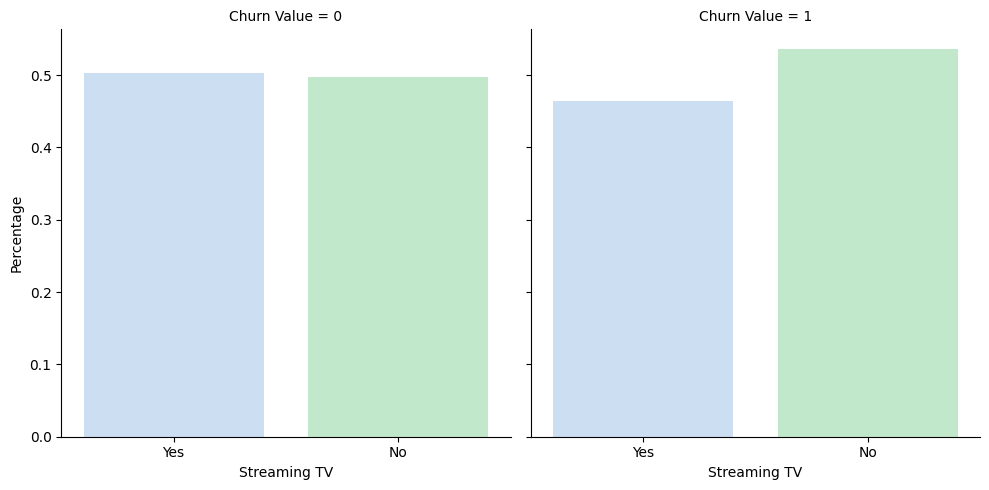

In [18]:
categorical_var_churn_dist('Streaming TV','Internet Service')

Streaming Movies  summary: 
     Churn Value     Streaming Movies  Percentage
0            0                  Yes    0.369927
1            0                   No    0.356977
2            0  No internet service    0.273096
3            1                   No    0.501873
4            1                  Yes    0.437667
5            1  No internet service    0.060460


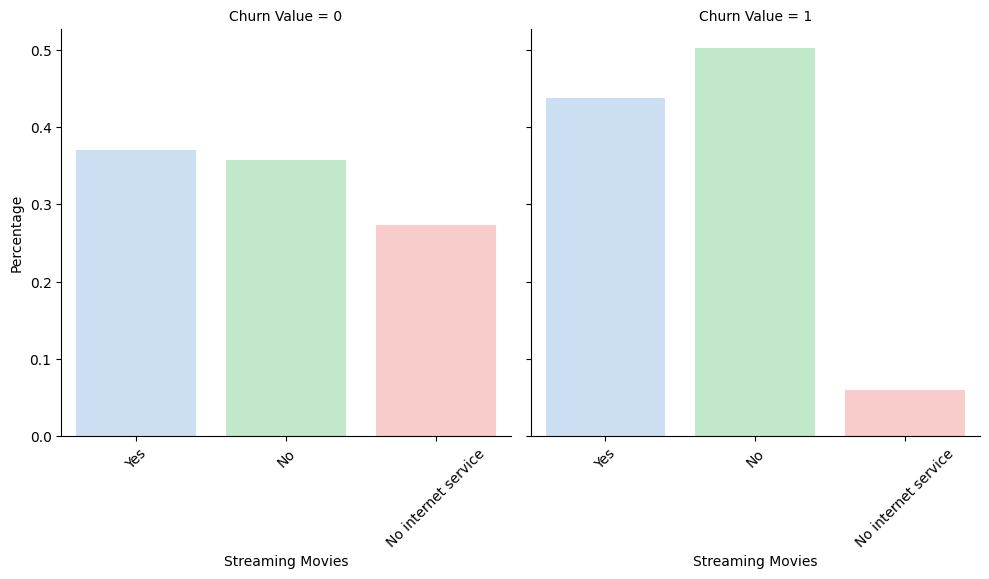

In [19]:
categorical_var_churn_dist('Streaming Movies')

Online Security  summary: 
     Churn Value Online Security  Percentage
0            0              No    0.541611
1            0             Yes    0.458389
2            1              No    0.832005
3            1             Yes    0.167995


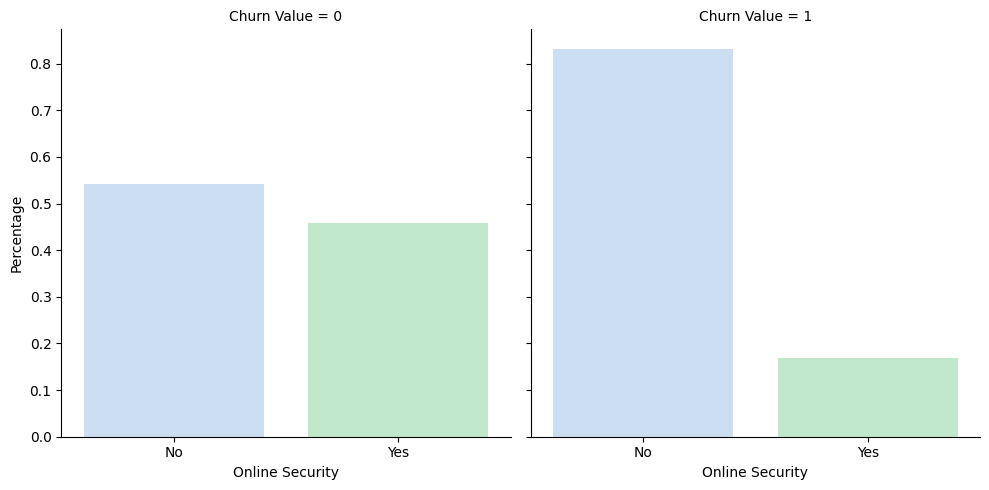

In [20]:
categorical_var_churn_dist('Online Security','Internet Service')

Online Backup  summary: 
     Churn Value Online Backup  Percentage
0            0           Yes    0.506780
1            0            No    0.493220
2            1            No    0.702164
3            1           Yes    0.297836


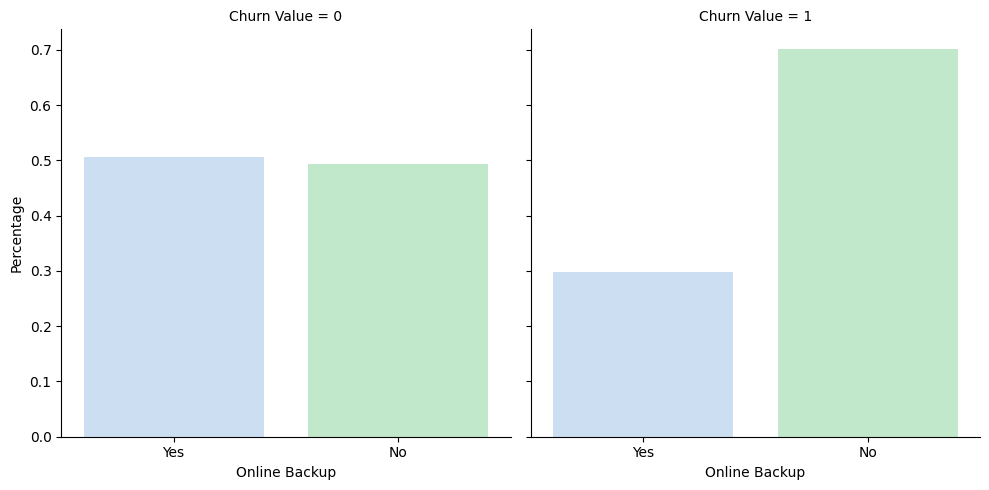

In [21]:
categorical_var_churn_dist('Online Backup','Internet Service')

Device Protection  summary: 
     Churn Value Device Protection  Percentage
0            0                No    0.500931
1            0               Yes    0.499069
2            1                No    0.689636
3            1               Yes    0.310364


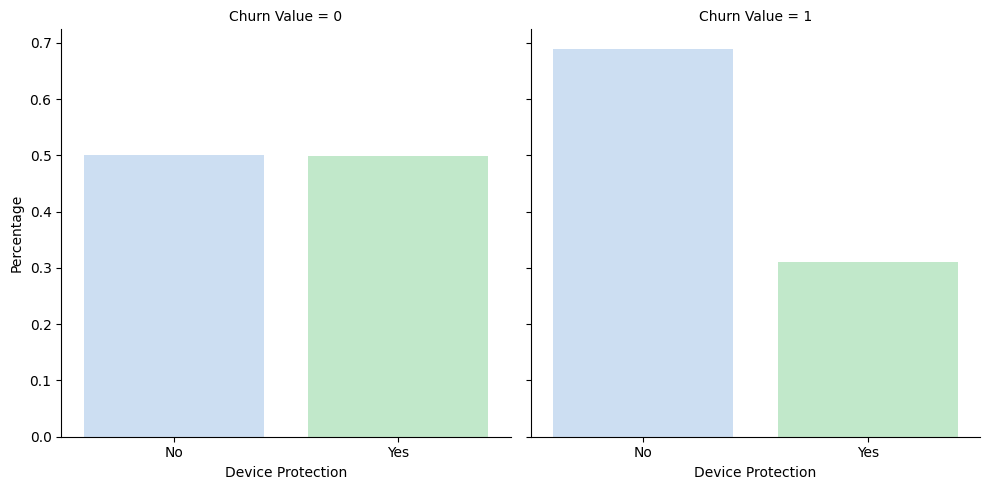

In [22]:
categorical_var_churn_dist('Device Protection','Internet Service')

Tech Support  summary: 
     Churn Value Tech Support  Percentage
0            0           No    0.538952
1            0          Yes    0.461048
2            1           No    0.823462
3            1          Yes    0.176538


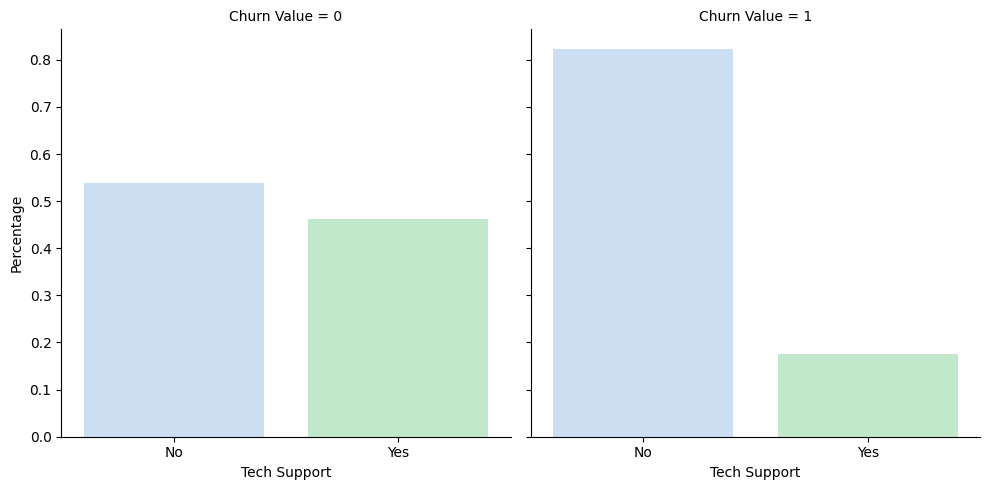

In [23]:
categorical_var_churn_dist('Tech Support','Internet Service')

<b>In internet service/usage, churn subscriber has highly likely to have Streaming Movies compared to existing subscriber </b>

Paperless Billing  summary: 
     Churn Value Paperless Billing  Percentage
0            0               Yes    0.535562
1            0                No    0.464438
2            1               Yes    0.749064
3            1                No    0.250936


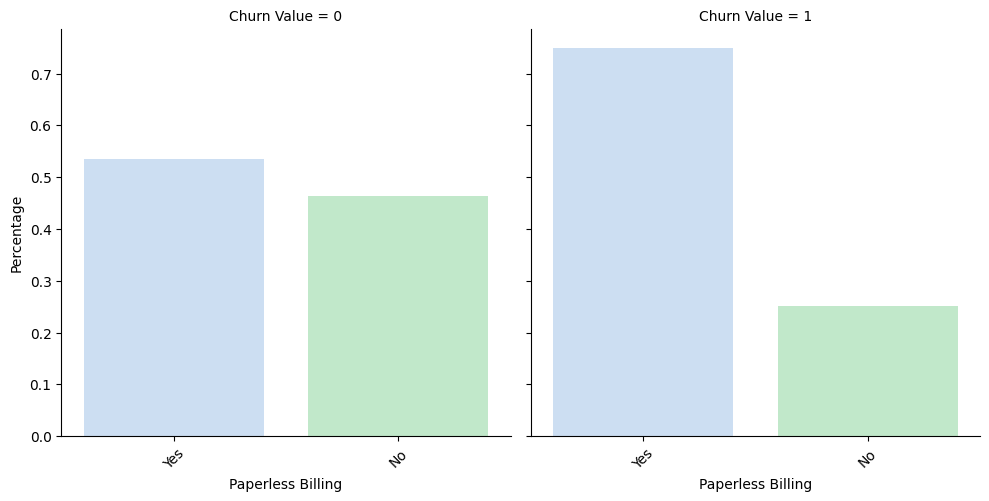

In [24]:
categorical_var_churn_dist('Paperless Billing')

<b>74% of the churn subscriber has paperlessbilling method compared to 53% of the existing subscriber.</b>

Contract  summary: 
     Churn Value        Contract  Percentage
0            0  Month-to-month    0.429068
1            0        Two year    0.318322
2            0        One year    0.252609
3            1  Month-to-month    0.885500
4            1        One year    0.088818
5            1        Two year    0.025682


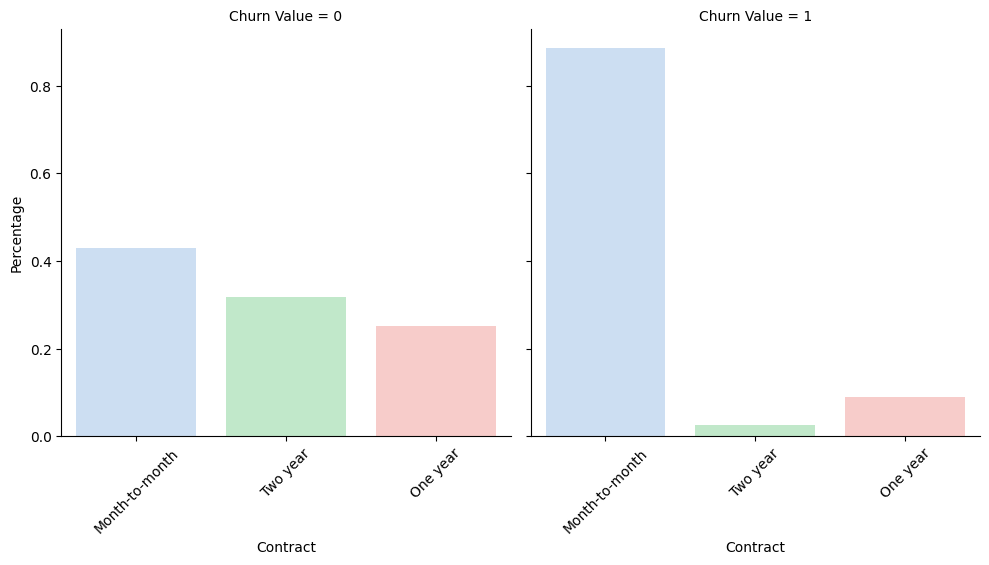

In [25]:
categorical_var_churn_dist('Contract')

<b> 88% of churn subscriber has Month-to-month service, means not contracted with company </b>

Payment Method  summary: 
     Churn Value             Payment Method  Percentage
0            0               Mailed check    0.252029
1            0           Electronic check    0.250097
2            0    Credit card (automatic)    0.249324
3            0  Bank transfer (automatic)    0.248550
4            1           Electronic check    0.573034
5            1               Mailed check    0.164794
6            1  Bank transfer (automatic)    0.138042
7            1    Credit card (automatic)    0.124131


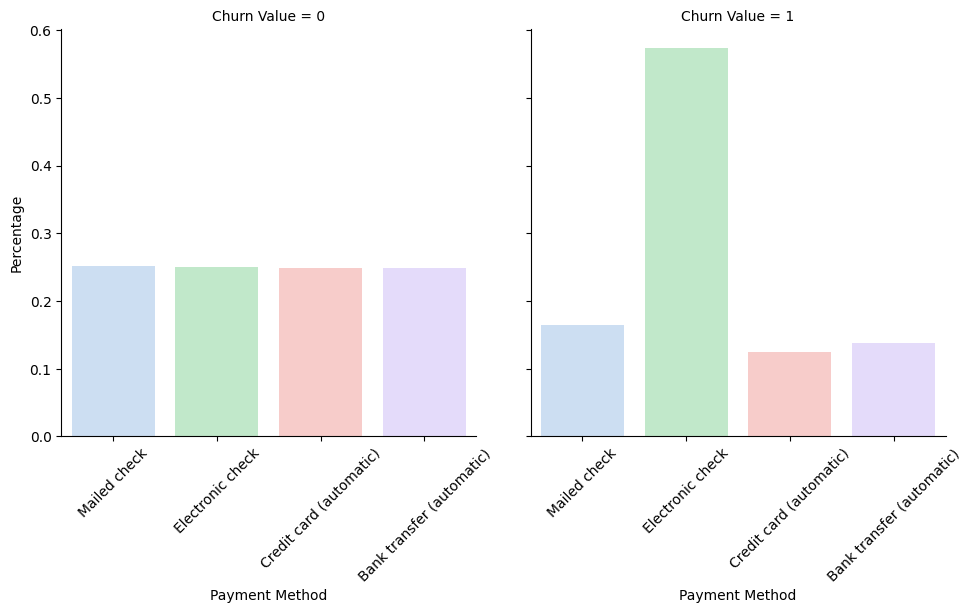

In [26]:
categorical_var_churn_dist('Payment Method')

### Distribution of Tenure, Monthly Charges

- Right now, in our dataset, we have continuos variables are Tenure, MonthlyCharges and TotalCharges. so let's deep dive into this variables.

- Tenure Distribution shows that customers who has tenure around less than a year left the brand more
Monthly Charges Distribution shows that customers who has around more than $65 left brands more

In [27]:
def numerical_distribution(feature):
    label = {'Tenure Months':'Tenure','Monthly Charges':'Charges','Total Charges':'Total Charges'}
    fig = plt.figure(figsize=(15,10))
    plt.subplot(2,1,1)
    ax = sns.kdeplot(data=telecom_data, x= feature, fill = True, linewidth=0, color='darkcyan')
    title_str =  f"{label[feature]} Distribution(in Months)"
    plt.title(title_str)
    plt.subplot(2,1,2)
    ax=sns.kdeplot(data=telecom_data, x=feature, hue='Churn Label', fill=True, common_norm=False, palette="crest",alpha=.5, linewidth=0)
    title_str = f"{label[feature]} Distribution: Churn vs No churn (in Months)"
    plt.title(title_str)
    plt.show()

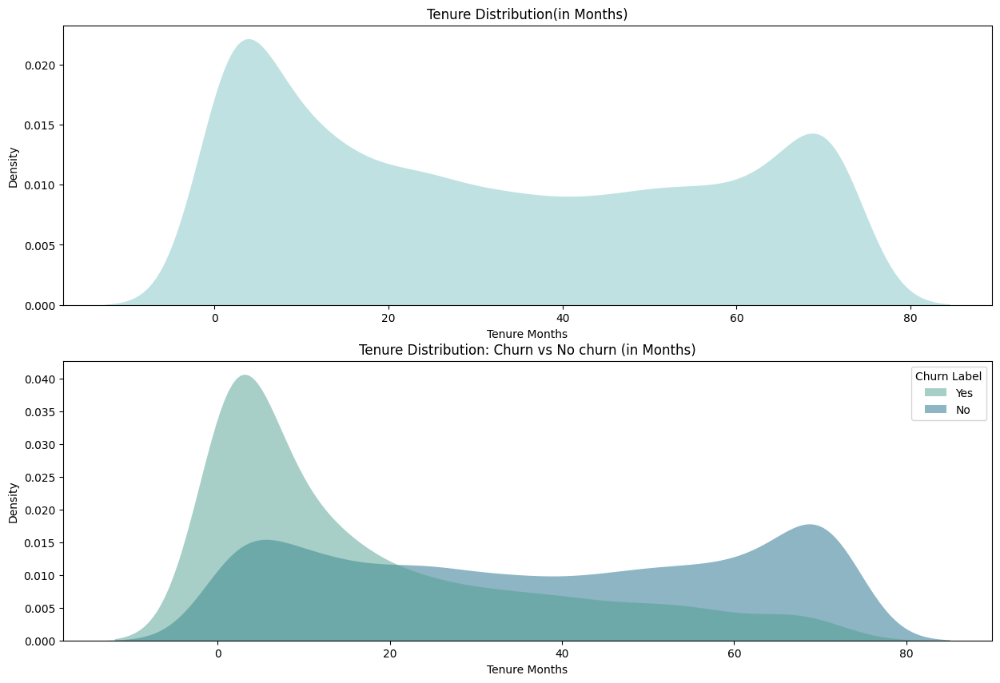

In [28]:
numerical_distribution('Tenure Months')

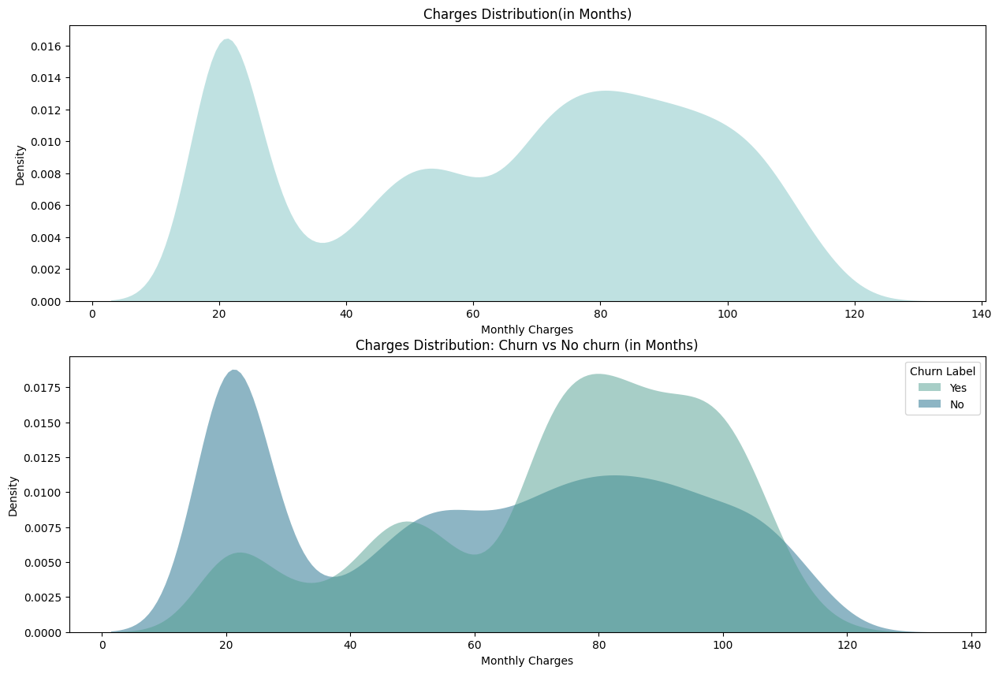

In [29]:
numerical_distribution('Monthly Charges')

In [30]:
telecom_data['Total Charges'] = telecom_data['Total Charges'].replace(' ','0.0')

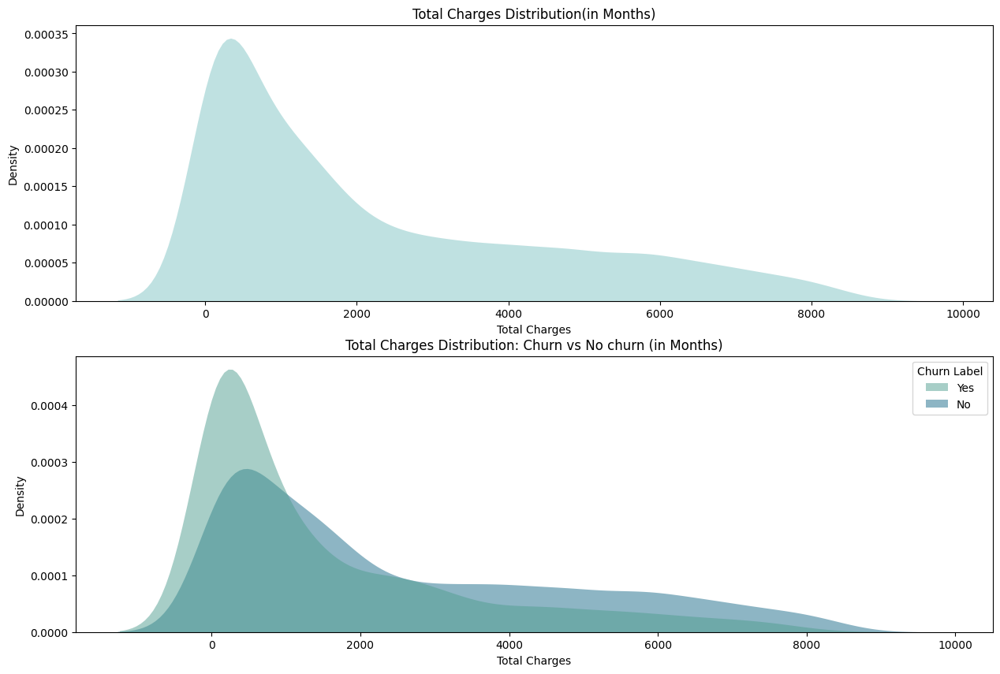

In [31]:
telecom_data = telecom_data.astype({'Total Charges': 'float64'})
numerical_distribution('Total Charges')

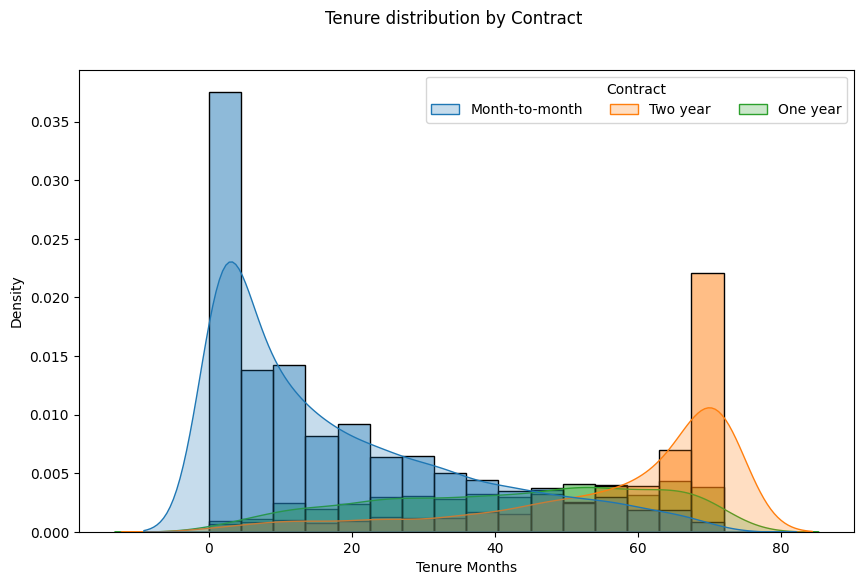

In [32]:
fig, ax = plt.subplots(figsize=(10, 6))
sns.histplot(x='Tenure Months', hue='Contract', data=telecom_data, ax=ax,
             kde=False, fill=True, stat='density', common_norm=True,
             multiple='layer')
sns.kdeplot(x='Tenure Months', hue='Contract', data=telecom_data,
            ax=ax, fill=True, multiple='layer')

fig.suptitle('Tenure distribution by Contract')

sns.move_legend(ax, 'upper right', ncol=3)

plt.show()

As can be seen, most of the monthly contracts last for a few months, while the 2 years contracts tend to last for years, with a great increase towards the greater values of tenure in this dataset. This implies that customers with a great commitment at the beginning, like a 2-year contract, tend to stay with the company for a longer period of time. Long-term contracts usually have contractual fines. Therefore, customers have to wait until the end of the contract to churn. It is not clear if it is the case. A time-series data would be better to study this.

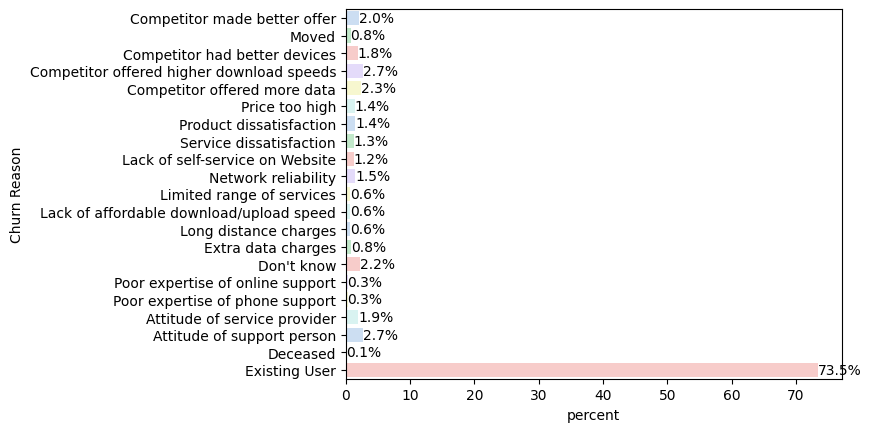

In [33]:
ax = sns.countplot(
    data=telecom_data,
    y='Churn Reason',
    hue='Churn Reason',
    stat='percent',
    alpha=0.6,
    palette=sns.color_palette("pastel6")
)

for patch in ax.patches:
    width = patch.get_width()
    ax.text(
        width, 
        patch.get_y() + patch.get_height() / 2, 
        f'{width*0.01:.1%}',
        va='center'
    )

plt.show()

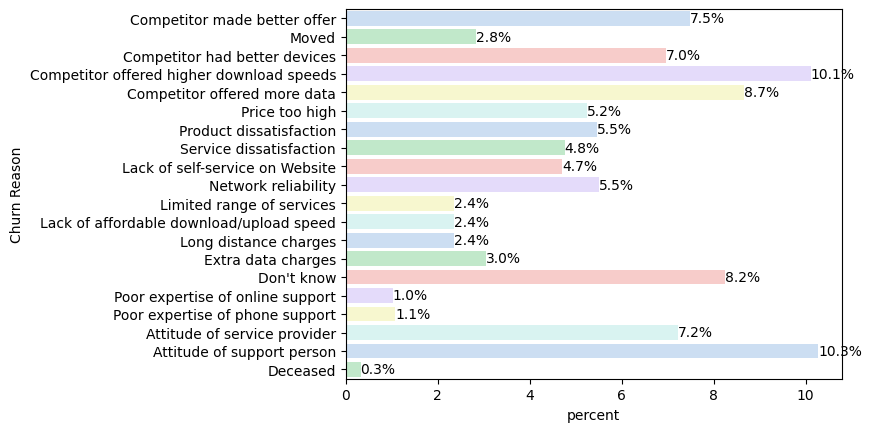

In [34]:
ax = sns.countplot(
    data=telecom_data[telecom_data['Churn Value']==1],
    y='Churn Reason',
    hue='Churn Reason',
    stat='percent',
    alpha=0.6,
    palette=sns.color_palette("pastel6")
)

for patch in ax.patches:
    width = patch.get_width()
    ax.text(
        width, 
        patch.get_y() + patch.get_height() / 2, 
        f'{width*0.01:.1%}',
        va='center')

plt.show()

In [35]:
city_list = list(telecom_data['City'].unique())

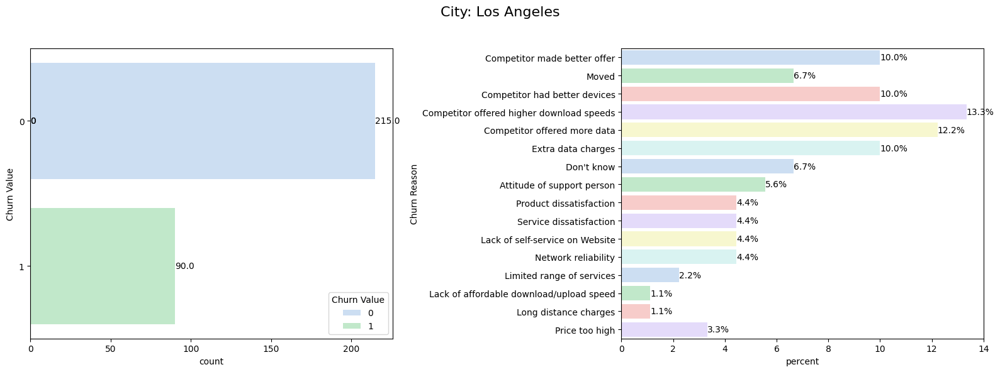

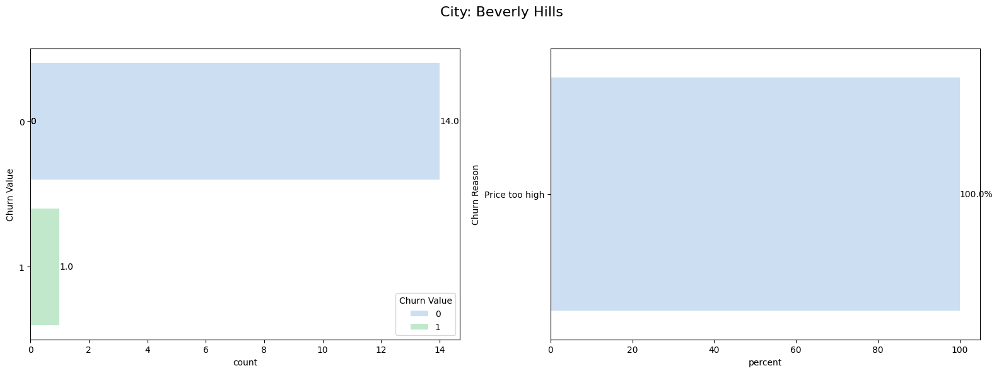

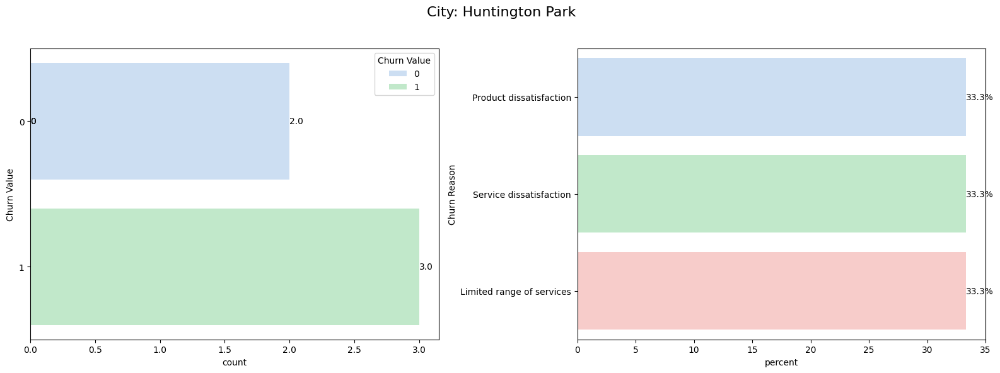

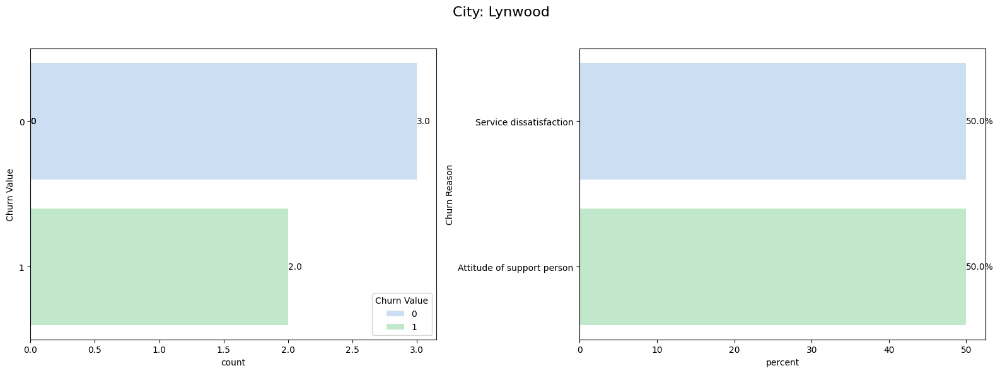

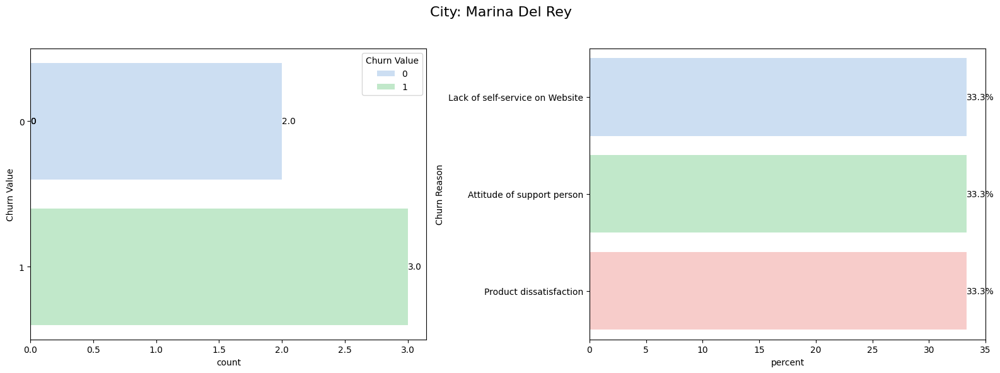

...

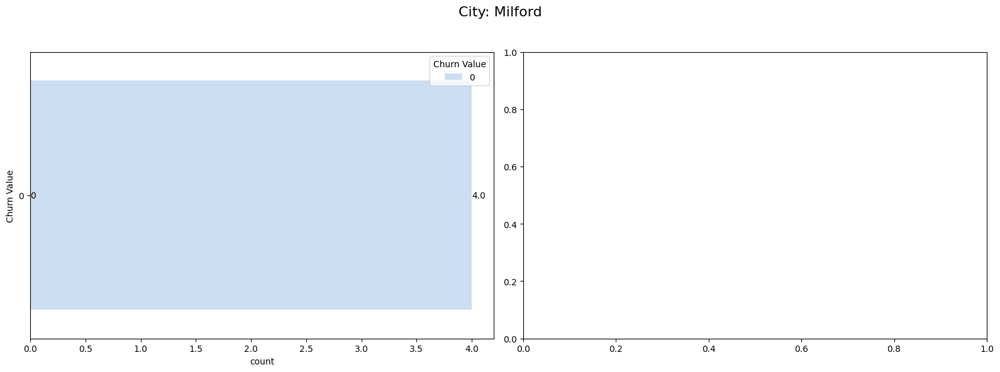

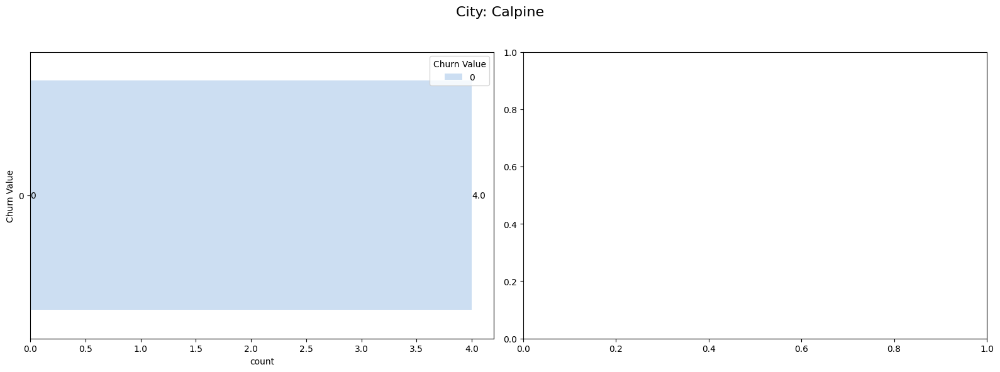

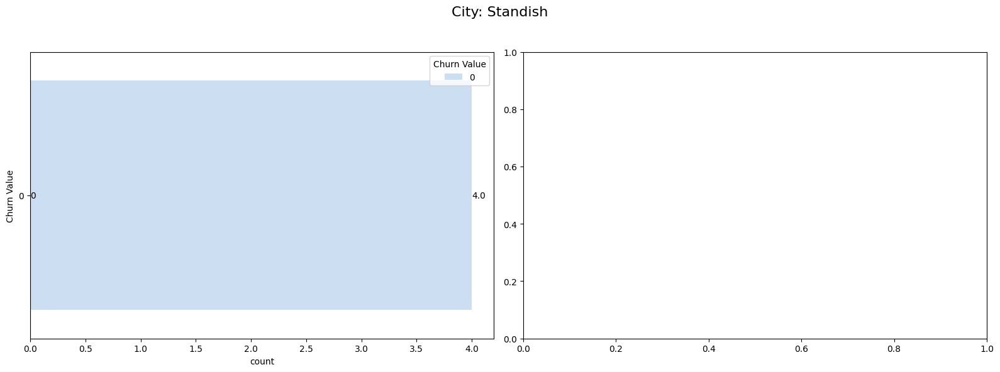

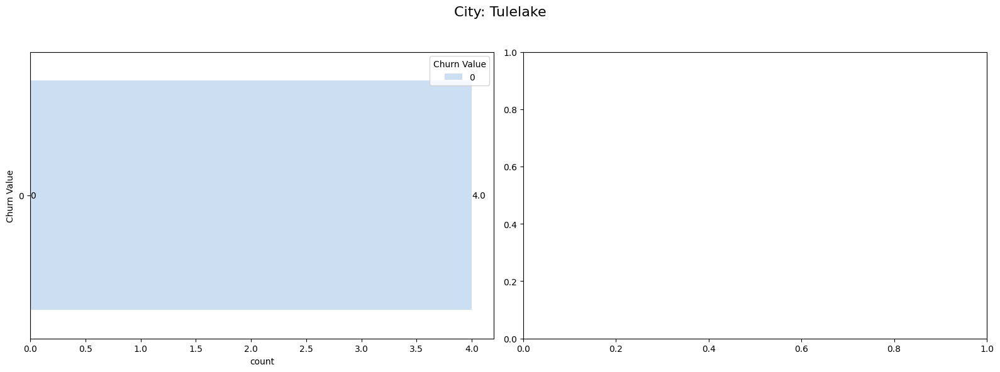

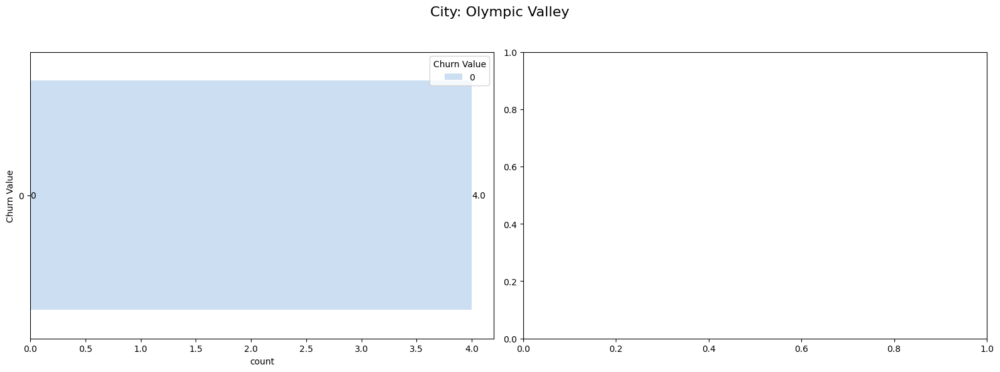

In [38]:
for city in city_list:
    # Create a figure with 1 row and 2 columns for side-by-side plots
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))
    
    # First plot: Countplot for 'Churn Value' for the current city
    ax1 = axes[0]
    sns.countplot(
        data=telecom_data[telecom_data['City'] == city],
        y='Churn Value',
        hue='Churn Value',
        alpha=0.6,
        palette=sns.color_palette("pastel6"),
        ax=ax1
    )
    
    # Add labels to the first plot
    for patch in ax1.patches:
        width = patch.get_width()
        ax1.text(
            width, 
            patch.get_y() + patch.get_height() / 2, 
            f'{width:}',
            va='center'
        )
    
    # Second plot: Countplot for 'Churn Reason' where 'Churn Value' == 1 for the current city
    ax2 = axes[1]
    sns.countplot(
        data=telecom_data[(telecom_data['Churn Value'] == 1) & (telecom_data['City'] == city)],
        y='Churn Reason',
        hue='Churn Reason',
        stat='percent',
        alpha=0.6,
        palette=sns.color_palette("pastel6"),
        ax=ax2
    )
    
    # Add labels to the second plot
    for patch in ax2.patches:
        width = patch.get_width()
        ax2.text(
            width, 
            patch.get_y() + patch.get_height() / 2, 
            f'{width * 0.01:.1%}',
            va='center'
        )
    
    # Set a title for the figure using the current city name
    fig.suptitle(f'City: {city}', fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # adjust layout to fit the suptitle
    plt.show()


In [43]:
# Aggregate churn data (where 'Churn Value' == 1) by City, Latitude, and Longitude
churn_density = telecom_data[telecom_data['Churn Value'] == 1].groupby(
    ['City', 'Latitude', 'Longitude']
).size().reset_index(name='ChurnCount')

# Determine the minimum and maximum churn counts to set the colormap scale
min_count = churn_density['ChurnCount'].min()
max_count = churn_density['ChurnCount'].max()

# Create a linear colormap using a palette (e.g., Yellow-Orange-Red)
colormap = cm.linear.YlOrRd_09.scale(min_count, max_count)
colormap.caption = 'Churn Density'

# Calculate the center of the map (for example, the mean of all coordinates)
center_lat = churn_density['Latitude'].mean()
center_lon = churn_density['Longitude'].mean()

# Create the Folium map
m = folium.Map(location=[center_lat, center_lon], zoom_start=6)

# Add a circle marker for each city, with a color based on churn density
for idx, row in churn_density.iterrows():
    density = row['ChurnCount']
    color = colormap(density)  # Map density to a color
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5 + density * 0.5,  # Adjust scaling factor as needed
        popup=f"{row['City']}: {density} churns",
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
    ).add_to(m)

# Add the colormap legend to the map
colormap.add_to(m)

# Display the map (in a Jupyter Notebook, simply output m)
m